# Happy Whale YOLOv8 Train and Predict


In [1]:
#!rm -rf 

In [2]:
!pip install wandb
!wandb --version
!pip install ultralytics

wandb, version 0.15.9
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.5/644.5 kB 8.8 MB/s eta 0:00:00


In [ ]:
# Wandb login:
from github_secrets import UserSecretsClient
import wandb
user_secrets = UserSecretsClient()
secret_value = user_secrets.get_secret("wandb_api_key")
wandb.login(key=secret_value)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [4]:
import os
import cv2
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image
import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.0.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 5016.7/8062.4 GB disk)


In [ ]:
dir0='/data/input/happy-whale-annotation-data-for-yolo/datasets'
class_names=['whale','dolphin']
print(class_names)
N=list(range(len(class_names)))
normal_mapping=dict(zip(class_names,N)) 
reverse_mapping=dict(zip(N,class_names))   

['whale', 'dolphin']


In [6]:
!mkdir datasets

# Create yaml file 

In [ ]:
import yaml

data_yaml = dict(
    train = os.path.join(dir0,'train'),
    val = os.path.join(dir0,'valid'),
    test = os.path.join(dir0,'test'),
    nc = len(class_names),
    names = class_names
)

with open('data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)
    
%cat data.yaml

# Train

In [8]:
model = YOLO("yolov8x.pt") 

100%|██████████| 131M/131M [00:00<00:00, 215MB/s]


In [9]:
!yolo task=detect mode=train model=yolov8x.pt data=data.yaml epochs=30 imgsz=480

Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.0.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=data.yaml, epochs=30, patience=50, batch=16, imgsz=480, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False,

# Result of Training

In [ ]:
paths2=[]
types=set()
for dirname, _, filenames in os.walk('/data/working/runs/detect/train'):
    for filename in filenames:
        types.add(filename[-4:])
        if filename.endswith('.jpg') or filename.endswith('.png'):
            paths2+=[(os.path.join(dirname, filename))]
paths2=sorted(paths2)
# print(len(paths2))
# print(paths2[0:3])
# print(types)

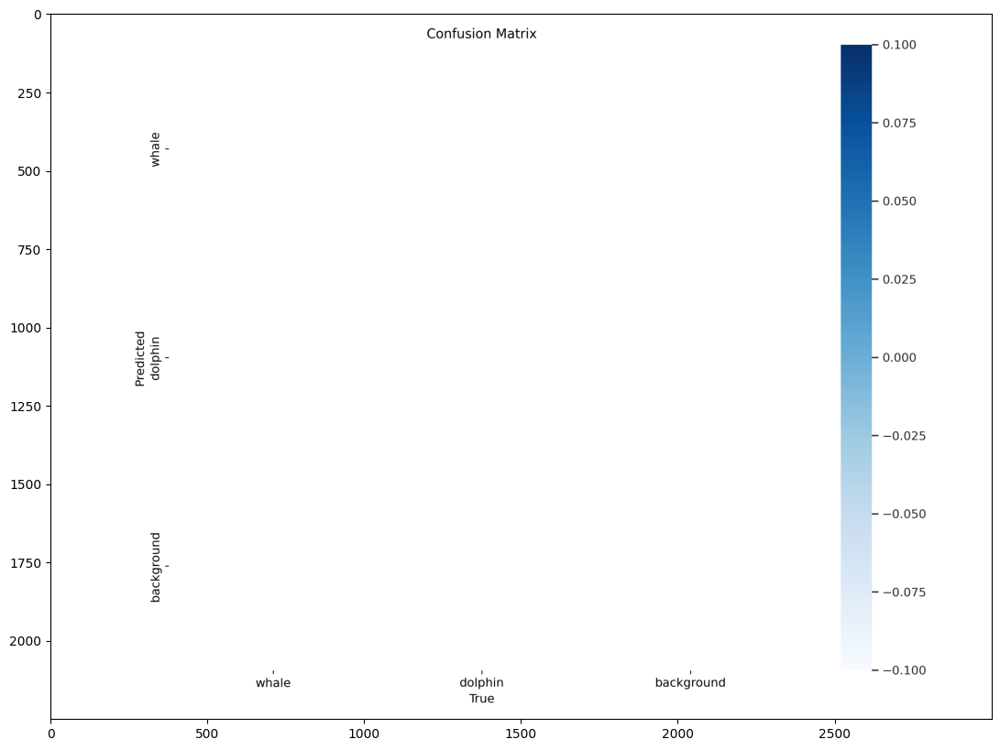

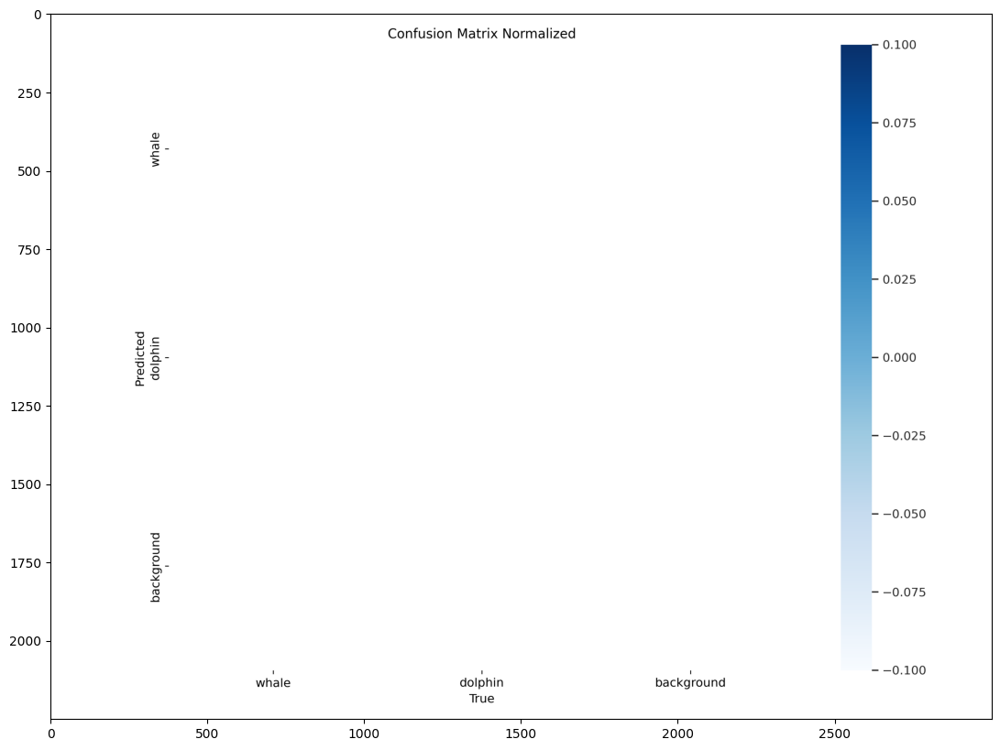

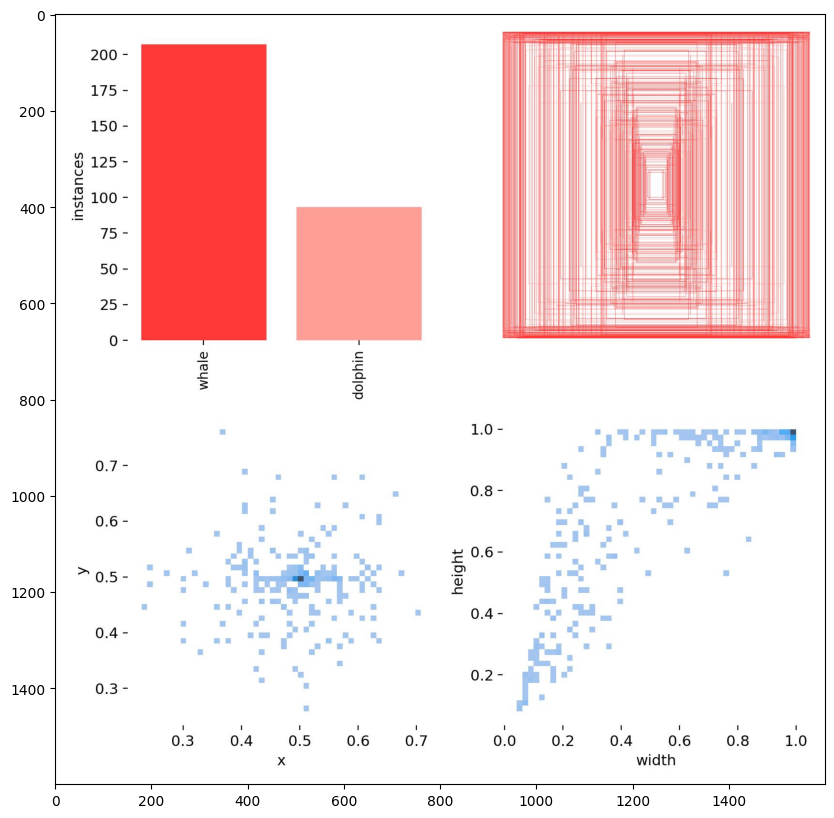

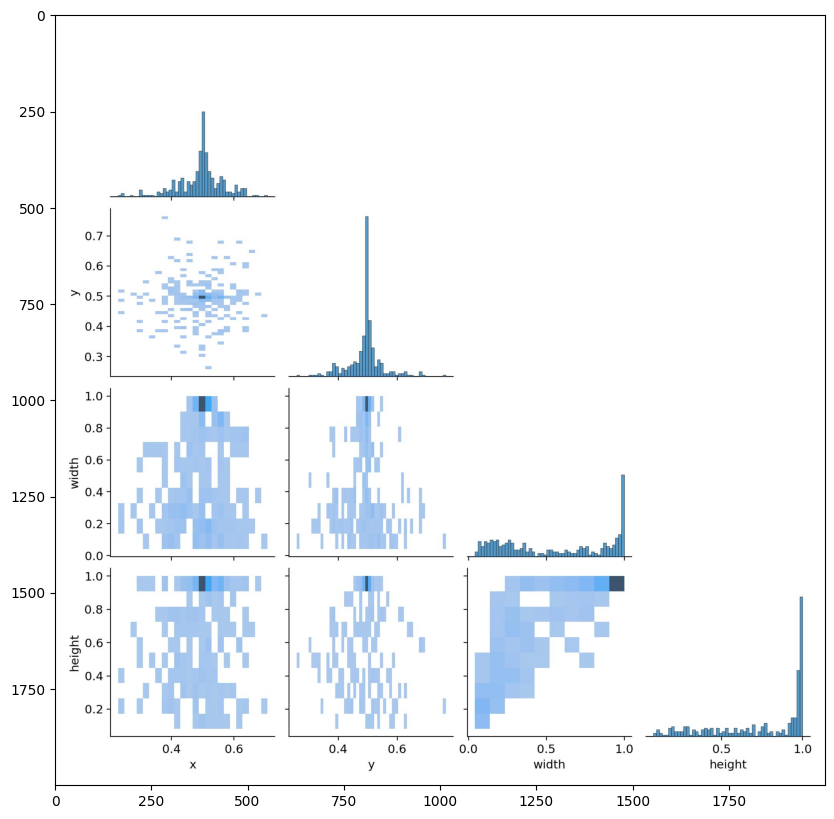

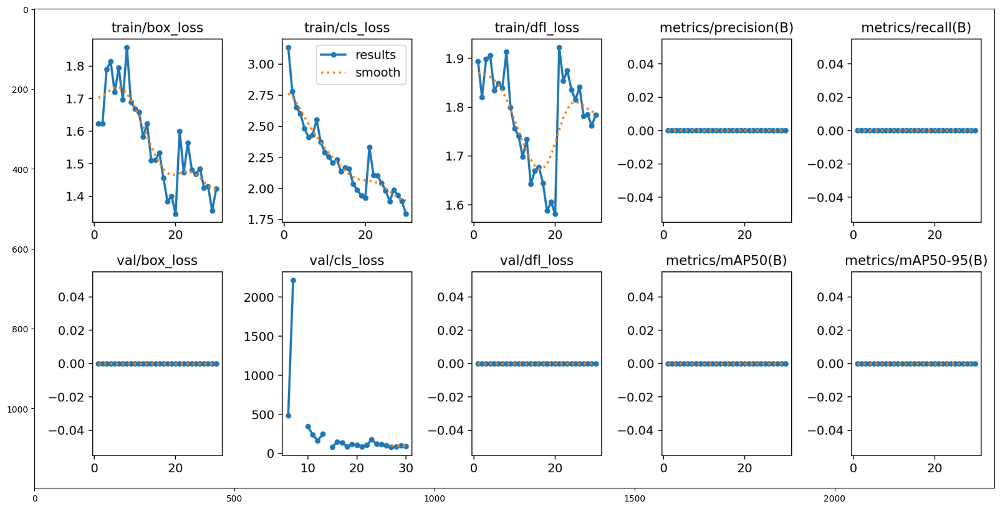

...

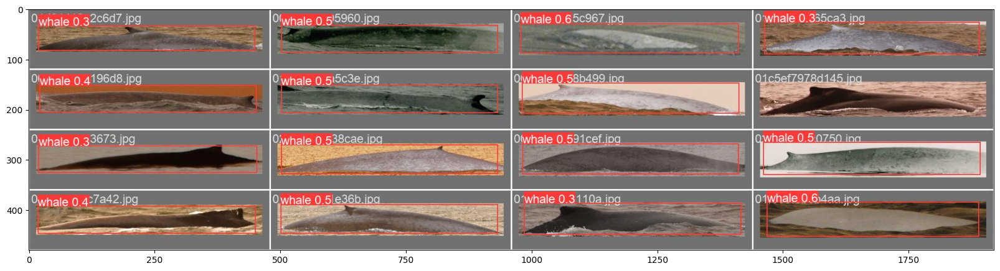

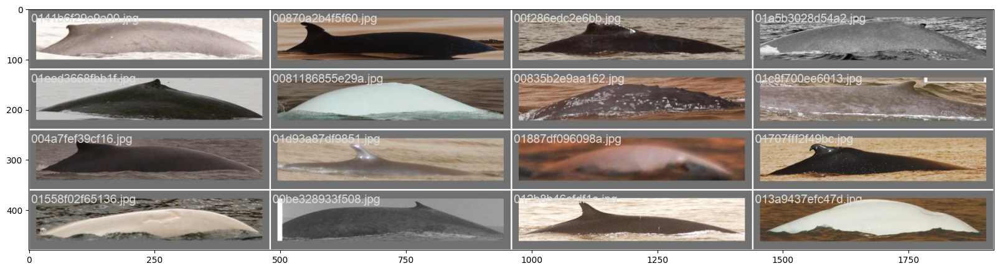

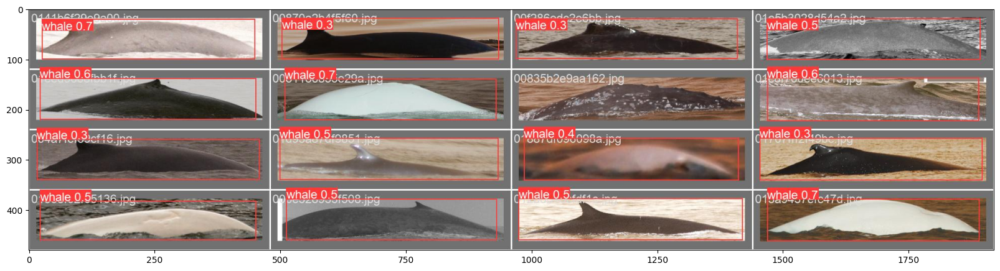

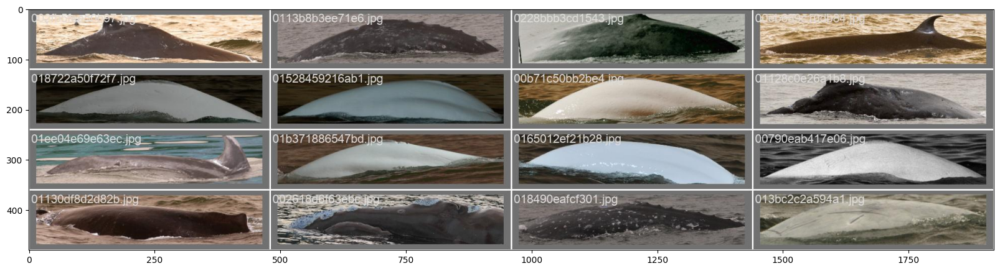

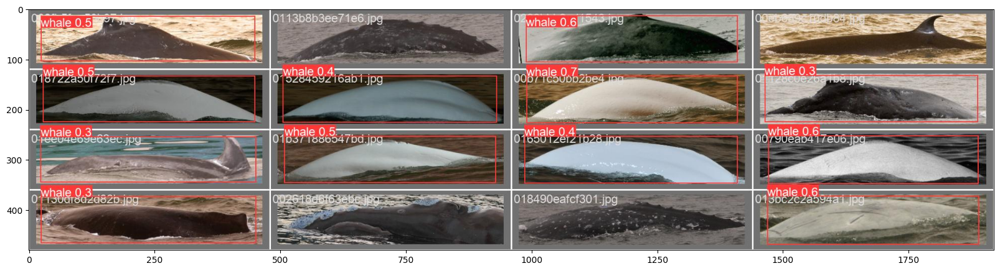

In [11]:
for path in paths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

# Predict

In [12]:
best_path0='runs/detect/train/weights/best.pt'
source0= os.path.join(dir0,'test')

In [13]:
!ls runs/detect/train/

args.yaml					  train_batch380.jpg
confusion_matrix.png				  train_batch381.jpg
confusion_matrix_normalized.png			  train_batch382.jpg
events.out.tfevents.1697871306.a482ff72cd68.94.0  val_batch0_labels.jpg
labels.jpg					  val_batch0_pred.jpg
labels_correlogram.jpg				  val_batch1_labels.jpg
results.csv					  val_batch1_pred.jpg
results.png					  val_batch2_labels.jpg
train_batch0.jpg				  val_batch2_pred.jpg
train_batch1.jpg				  weights
train_batch2.jpg


In [14]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(len(ppaths))

100


In [15]:
model2 = YOLO(best_path0)

In [ ]:
!yolo task=detect mode=predict model={best_path0} conf=0.15 source={source0}

# Result of Prediction

In [ ]:
results = model2.predict(source0,conf=0.15)
# print(len(results))
# print(len(ppaths))

In [18]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,7.695125,4.539114,675.188965,214.000000,0.158214,0.0,022f1a1ba650e1.jpg,0.0
0,34.416531,43.893559,3514.014404,2154.221436,0.354949,0.0,022f3c80ae8e8b.jpg,1.0
1,13.399804,55.236126,3496.113525,2156.588135,0.207010,1.0,022f3c80ae8e8b.jpg,1.0
0,90.131569,38.199272,2676.830811,1171.282715,0.184027,0.0,023099ebf6f825.jpg,3.0
0,0.000000,13.474336,1304.971802,259.471283,0.214905,0.0,02312d50b8c24e.jpg,4.0
...,...,...,...,...,...,...,...,...
1,3.451971,10.067873,637.058105,402.471893,0.201593,1.0,02a6ca2bcd1b46.jpg,96.0
0,27.771832,12.214494,2496.276367,675.394653,0.284209,0.0,02a77dc574ba0d.jpg,97.0
0,3.634918,1.928168,420.733673,114.446198,0.344045,0.0,02aacae6442f52.jpg,98.0
0,6.943661,6.155648,550.338440,333.143585,0.366570,0.0,02ab974b1d2f49.jpg,99.0


In [19]:
PBOX['class']=PBOX['class'].apply(lambda x: reverse_mapping[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,7.695125,4.539114,675.188965,214.000000,0.158214,whale,022f1a1ba650e1.jpg,0.0
1,34.416531,43.893559,3514.014404,2154.221436,0.354949,whale,022f3c80ae8e8b.jpg,1.0
2,13.399804,55.236126,3496.113525,2156.588135,0.207010,dolphin,022f3c80ae8e8b.jpg,1.0
3,90.131569,38.199272,2676.830811,1171.282715,0.184027,whale,023099ebf6f825.jpg,3.0
4,0.000000,13.474336,1304.971802,259.471283,0.214905,whale,02312d50b8c24e.jpg,4.0
...,...,...,...,...,...,...,...,...
91,3.451971,10.067873,637.058105,402.471893,0.201593,dolphin,02a6ca2bcd1b46.jpg,96.0
92,27.771832,12.214494,2496.276367,675.394653,0.284209,whale,02a77dc574ba0d.jpg,97.0
93,3.634918,1.928168,420.733673,114.446198,0.344045,whale,02aacae6442f52.jpg,98.0
94,6.943661,6.155648,550.338440,333.143585,0.366570,whale,02ab974b1d2f49.jpg,99.0


class
whale      80
dolphin    16
Name: count, dtype: int64

In [20]:
for i in range(len(PBOX)):
    judged_name=PBOX.loc[i,'class'][5:].replace(' ','_')
    #print(judged_name)
    file=PBOX.loc[i,'file']
    if judged_name in file:
        PBOX.loc[i,'judge']=True
    else:
        PBOX.loc[i,'judge']=False
display(PBOX['judge'].value_counts())

judge
True     80
False    16
Name: count, dtype: int64

In [21]:
display(PBOX)

,x,y,x2,y2,confidence,class,file,i,judge
0,7.695125,4.539114,675.188965,214.000000,0.158214,whale,022f1a1ba650e1.jpg,0.0,True
1,34.416531,43.893559,3514.014404,2154.221436,0.354949,whale,022f3c80ae8e8b.jpg,1.0,True
2,13.399804,55.236126,3496.113525,2156.588135,0.207010,dolphin,022f3c80ae8e8b.jpg,1.0,False
3,90.131569,38.199272,2676.830811,1171.282715,0.184027,whale,023099ebf6f825.jpg,3.0,True
4,0.000000,13.474336,1304.971802,259.471283,0.214905,whale,02312d50b8c24e.jpg,4.0,True
...,...,...,...,...,...,...,...,...,...
91,3.451971,10.067873,637.058105,402.471893,0.201593,dolphin,02a6ca2bcd1b46.jpg,96.0,False
92,27.771832,12.214494,2496.276367,675.394653,0.284209,whale,02a77dc574ba0d.jpg,97.0,True
93,3.634918,1.928168,420.733673,114.446198,0.344045,whale,02aacae6442f52.jpg,98.0,True
94,6.943661,6.155648,550.338440,333.143585,0.366570,whale,02ab974b1d2f49.jpg,99.0,True


In [22]:
def draw_box2(n0):
    
    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]    
    image=cv2.resize(image,dsize=(600,400))
    file=ipath.split('/')[-1]
    
    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x']*600/W)
            y=int(box.loc[i,'y']*400/H)
            x2=int(box.loc[i,'x2']*600/W) 
            y2=int(box.loc[i,'y2']*400/H)
            c=[(0,255,0),(255,0,0)]
            if label=='whale':
                cv2.putText(image, f'{label}', (x, y+30), 
                        cv2.FONT_HERSHEY_SIMPLEX, 2.0, c[0],4)
                cv2.rectangle(image,(x,y),(x2,y2),c[0],4)
            else:
                cv2.putText(image, f'{label}', (x, y+30), 
                        cv2.FONT_HERSHEY_SIMPLEX, 2.0, c[1],4)
                cv2.rectangle(image,(x,y),(x2,y2),c[1],4)               

    return image

In [23]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {i}')        
        return [im]    
    
    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [24]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

100%|██████████| 100/100 [00:02<00:00, 37.61it/s]


In [25]:
create_animation(images2)